In [294]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
#import seaborn as sns
import datetime
from math import radians, cos, sin, asin, sqrt
from sklearn.cluster import DBSCAN
import geopandas as gpd
import shapely as shapely
from shapely.geometry import Point
import folium
from folium import FeatureGroup, LayerControl, Map, Marker
from folium.plugins import HeatMap
from folium import plugins

In [2]:
train = pd.read_csv('nyc_taxis.csv')

In [3]:
train.head()

,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration
0,id2875421,2,2016-03-14 17:24:55,2016-03-14 17:32:30,1,-73.982155,40.767937,-73.964630,40.765602,N,455
1,id2377394,1,2016-06-12 00:43:35,2016-06-12 00:54:38,1,-73.980415,40.738564,-73.999481,40.731152,N,663
2,id3858529,2,2016-01-19 11:35:24,2016-01-19 12:10:48,1,-73.979027,40.763939,-74.005333,40.710087,N,2124
3,id3504673,2,2016-04-06 19:32:31,2016-04-06 19:39:40,1,-74.010040,40.719971,-74.012268,40.706718,N,429
4,id2181028,2,2016-03-26 13:30:55,2016-03-26 13:38:10,1,-73.973053,40.793209,-73.972923,40.782520,N,435


In [4]:
def haversine_np(lon1, lat1, lon2, lat2):
    """
    Calculate the great circle distance between two points
    on the earth (specified in decimal degrees)
    All args must be of equal length.
    """
    lon1, lat1, lon2, lat2 = map(np.radians, [lon1, lat1, lon2, lat2])
    dlon = lon2 - lon1
    dlat = lat2 - lat1
    a = np.sin(dlat/2.0)**2 + np.cos(lat1) * np.cos(lat2) * np.sin(dlon/2.0)**2
    c = 2 * np.arcsin(np.sqrt(a))
    km = 6367 * c
    return km

## Feature Generation

In [5]:
# Creating the distance column
train[['distance']] = 0

In [6]:
# Calculating the distance in kms using the haversine formula for every cell
train['distance'] = haversine_np(train.pickup_longitude, train.pickup_latitude, 
                              train.dropoff_longitude,train.dropoff_latitude)

In [7]:
# Converting to datetime objects
train['pickup_datetime']=pd.to_datetime(train['pickup_datetime'],errors='coerce')

train['dropoff_datetime']=pd.to_datetime(train['dropoff_datetime'],errors='coerce')

In [8]:
train.head()

,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration,distance
0,id2875421,2,2016-03-14 17:24:55,2016-03-14 17:32:30,1,-73.982155,40.767937,-73.964630,40.765602,N,455,1.497580
1,id2377394,1,2016-06-12 00:43:35,2016-06-12 00:54:38,1,-73.980415,40.738564,-73.999481,40.731152,N,663,1.804374
2,id3858529,2,2016-01-19 11:35:24,2016-01-19 12:10:48,1,-73.979027,40.763939,-74.005333,40.710087,N,2124,6.381090
3,id3504673,2,2016-04-06 19:32:31,2016-04-06 19:39:40,1,-74.010040,40.719971,-74.012268,40.706718,N,429,1.484566
4,id2181028,2,2016-03-26 13:30:55,2016-03-26 13:38:10,1,-73.973053,40.793209,-73.972923,40.782520,N,435,1.187842


**Mon = 0, Tue = 1, Wed = 2, Thurs = 3, Fri = 4, Sat = 5, Sun = 6**

In [9]:
# Creating day_of_week column
train[['day_of_week']] = ''

In [10]:
train['day_of_week'] = train['dropoff_datetime'].apply(lambda x: x.weekday())

**We convert the trip duration from seconds to hours by dividing seconds by 3600**

In [11]:
train['trip_duration_hrs'] = train['trip_duration']/3600

In [12]:
# Creating average_speed km/h column
train[['average_speed']] = 0

**Formula for speed is distance/time , we find speed Km/h**

In [13]:
train['average_speed'] = train['distance']/train['trip_duration_hrs']

In [14]:
train.head()

,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration,distance,day_of_week,trip_duration_hrs,average_speed
0,id2875421,2,2016-03-14 17:24:55,2016-03-14 17:32:30,1,-73.982155,40.767937,-73.964630,40.765602,N,455,1.497580,0,0.126389,11.848984
1,id2377394,1,2016-06-12 00:43:35,2016-06-12 00:54:38,1,-73.980415,40.738564,-73.999481,40.731152,N,663,1.804374,6,0.184167,9.797504
2,id3858529,2,2016-01-19 11:35:24,2016-01-19 12:10:48,1,-73.979027,40.763939,-74.005333,40.710087,N,2124,6.381090,1,0.590000,10.815406
3,id3504673,2,2016-04-06 19:32:31,2016-04-06 19:39:40,1,-74.010040,40.719971,-74.012268,40.706718,N,429,1.484566,2,0.119167,12.457894
4,id2181028,2,2016-03-26 13:30:55,2016-03-26 13:38:10,1,-73.973053,40.793209,-73.972923,40.782520,N,435,1.187842,5,0.120833,9.830418


## Data Cleaning

In [15]:
train.isnull().sum()

id                    0
vendor_id             0
pickup_datetime       0
dropoff_datetime      0
passenger_count       0
pickup_longitude      0
pickup_latitude       0
dropoff_longitude     0
dropoff_latitude      0
store_and_fwd_flag    0
trip_duration         0
distance              0
day_of_week           0
trip_duration_hrs     0
average_speed         0
dtype: int64

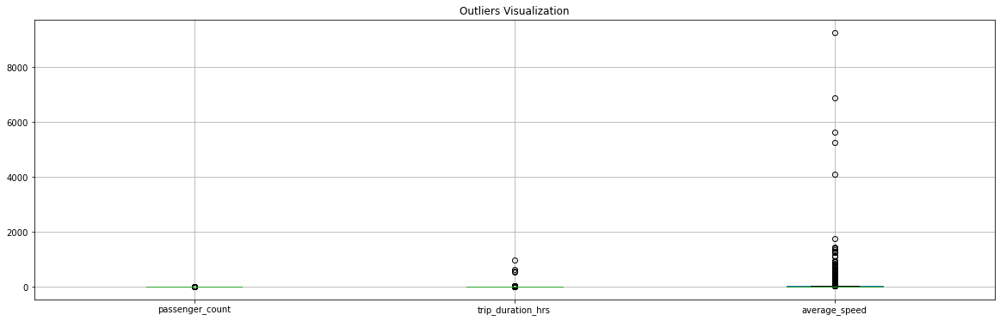

In [16]:
plt.subplots(figsize=(20,6))
plt.title("Outliers Visualization")
train.boxplot(column=['passenger_count','trip_duration_hrs','average_speed']);

In [17]:
train_new = train.copy()

In [18]:
min_p, max_p = train_new.passenger_count.quantile([0.001, 0.9999])
min_td, max_td = train_new.trip_duration_hrs.quantile([0.0001, 0.99])
min_as, max_as = train_new.average_speed.quantile([0.0001, 0.999])

In [19]:
train_new = train_new[(train_new.passenger_count > min_p) & (train_new.passenger_count < max_p)]
train_new = train_new[(train_new.trip_duration_hrs > min_td) & (train_new.trip_duration_hrs < max_td)]
train_new = train_new[(train_new.average_speed > min_as) & (train_new.average_speed < max_as)]

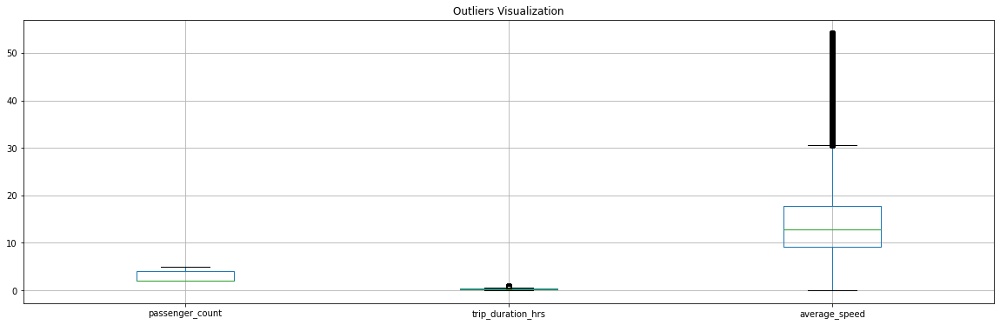

In [241]:
plt.subplots(figsize=(20,6))
plt.title("Outliers Visualization")
train_new.boxplot(column=['passenger_count','trip_duration_hrs','average_speed']);

In [21]:
print('Rows removed: ',train.shape[0] - train_new.shape[0])

Rows removed:  1088321


In [22]:
train_new.head()

,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration,distance,day_of_week,trip_duration_hrs,average_speed
6,id1813257,1,2016-06-17 22:34:59,2016-06-17 22:40:40,4,-73.969017,40.757839,-73.957405,40.765896,N,341,1.325446,4,0.094722,13.992977
11,id1299289,2,2016-05-15 11:16:11,2016-05-15 11:34:59,4,-73.991531,40.749439,-73.956543,40.770630,N,1128,3.770727,6,0.313333,12.034235
12,id1187965,2,2016-02-19 09:52:46,2016-02-19 10:11:20,2,-73.962982,40.756680,-73.984406,40.760719,N,1114,1.858316,4,0.309444,6.005329
32,id3075902,2,2016-05-10 19:27:38,2016-05-10 19:44:40,2,-74.005501,40.706589,-73.985817,40.744202,N,1022,4.496459,1,0.283889,15.838800
36,id1870624,1,2016-01-05 15:29:54,2016-01-05 15:39:07,3,-73.951515,40.770248,-73.958527,40.761517,N,553,1.135679,1,0.153611,7.393206


## Time-Based

In [23]:
#1
popularity_of_days = train_new.groupby('day_of_week').count()['id']

**We see from the below pie chart that Saturday appears to be the most popular day of the week**

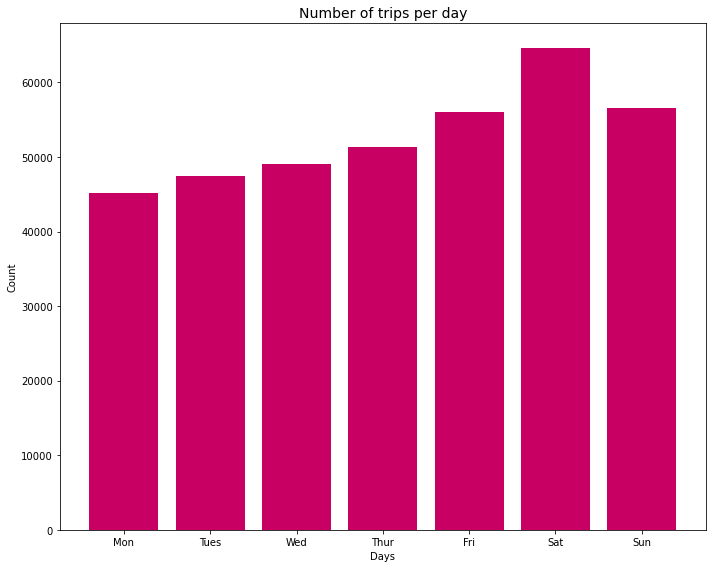

In [239]:
plt.bar(['Mon','Tues','Wed','Thur','Fri','Sat','Sun'],popularity_of_days,color='#c80064')
plt.title('Number of trips per day', fontsize=14)
plt.xlabel('Days')
plt.ylabel('Count')
plt.tight_layout()
plt.rcParams["figure.figsize"] = (10,8)

In [25]:
#2
popularity_of_hour = train_new.groupby('day_of_week')

**3**. We See that there is more trips on the weekends compared to the rest of the week and this could be beacuse people tend to use public transport when going out to avoid driving since they may be intoxicated with alcohol

**4. Major Holidays to be explored:**
- St. Patrick’s Day = 17 March
- Easter = 9 April
- Memorial Day = 30 May
- Valentine’s Day = 14 February
- Martin Luther King Day = 16 January

Sources are from Google

We see the pattern to continue, Easters are on Sundays and we see it has the most trips out of all the holidays

In [26]:
# Here we get the totals for the trips taken on each holiday

patricks = (train_new.pickup_datetime.dt.month == 3) & (train_new.pickup_datetime.dt.day == 17)
patricks = np.array(np.where(patricks == True))
psize = patricks.size

easter = (train_new.pickup_datetime.dt.month == 4) & (train_new.pickup_datetime.dt.day == 9)
easter = np.array(np.where(easter == True))
esize = easter.size

memorial = (train_new.pickup_datetime.dt.month == 5) & (train_new.pickup_datetime.dt.day == 30)
memorial = np.array(np.where(memorial == True))
msize = memorial.size

vday = (train_new.pickup_datetime.dt.month == 2) & (train_new.pickup_datetime.dt.day == 14)
vday = np.array(np.where(vday == True))
vsize = vday.size

mlk = (train_new.pickup_datetime.dt.month == 1) & (train_new.pickup_datetime.dt.day == 16)
mlk = np.array(np.where(mlk == True))
lsize = mlk.size

In [27]:
holidays=[psize,esize,msize,vsize,lsize]

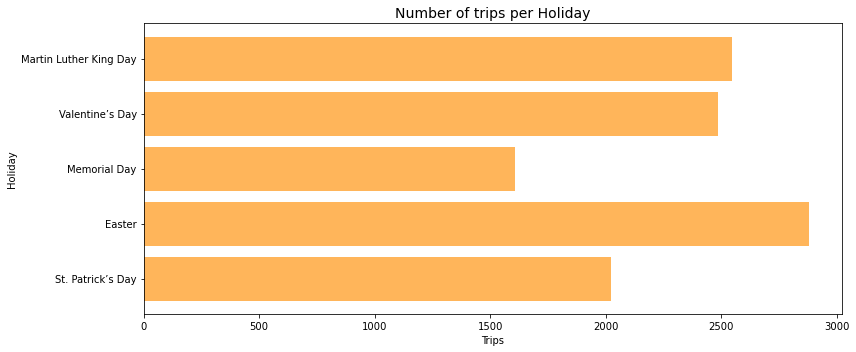

In [236]:
plt.barh(['St. Patrick’s Day','Easter','Memorial Day','Valentine’s Day','Martin Luther King Day'], holidays, color='#ffb55a')
plt.title('Number of trips per Holiday', fontsize=14)
plt.xlabel('Trips')
plt.ylabel('Holiday')
plt.tight_layout()
plt.rcParams["figure.figsize"] = (12,5)

## Location clusters

### Heatmaps

In [32]:
# - Early morning (4 hrs to 8 hrs)
# - Morning (8 hrs to 12 hrs) , 
# - Afternoon (12 hrs to 17 hrs) , 
# - Evening (17 hrs to  20 hrs),
# - Night (20 hrs to 0 hrs)
# - Mid night (0 hrs to 4hrs)


def period(a):
    if a in range(0,4):
        return 'Mid night'
    elif a in range(4,8):
        return "Early morning"
    elif a in range(8,12):
        return "Morning"
    elif a in range(12,17):
        return "Afternoon"
    elif a in range(17,20):
        return "Evening"
    else:
        return "Night"

# 0-4 (Mon-Fri)
# 5,6 (Sat,Sun)
def week_divide(b):
    if b > 4:
        return 'Weekend'
    else:
        return 'Weekday'

In [33]:
train_new['dropoff_timezone'] = train_new.apply(lambda x: period(x['dropoff_datetime'].hour),axis=1)

In [34]:
train_new['week_section'] = train_new.apply(lambda x: week_divide(x['day_of_week']),axis=1)

In [249]:
weekdays = train_new[train_new.week_section == 'Weekday']

- Heatmap for Weekdays

In [302]:
heat_list1=list(zip(weekdays.pickup_latitude.astype(float),weekdays.pickup_longitude.astype(float)))

In [308]:
weekdays_map = folium.Map(location = [40.730610,-73.935242],zoom_start = 10)
weekdays_map.add_child(plugins.HeatMap(heat_list1, radius=7,show=True))
weekdays_map

- HeatMap for Weekends

In [304]:
weekends = train_new[train_new.week_section == 'Weekend']

In [305]:
heat_list2=list(zip(weekends.pickup_latitude.astype(float),weekends.pickup_longitude.astype(float)))

In [307]:
weekends_map = folium.Map(location = [40.730610,-73.935242],zoom_start = 10)
weekends_map.add_child(plugins.HeatMap(heat_list2, radius=7,show=True))
weekends_map

In [309]:
mornings = train_new[train_new.dropoff_timezone == 'Morning']

In [310]:
evenings = train_new[train_new.dropoff_timezone == 'Evening']

- **HeatMap for Mornings**

In [312]:
heat_list3=list(zip(mornings.pickup_latitude.astype(float),mornings.pickup_longitude.astype(float)))

In [313]:
mornings_map = folium.Map(location = [40.730610,-73.935242],zoom_start = 10)
mornings_map.add_child(plugins.HeatMap(heat_list3, radius=7,show=True))
mornings_map

- **HeatMap for Evenings**

In [314]:
heat_list4=list(zip(evenings.pickup_latitude.astype(float),evenings.pickup_longitude.astype(float)))

In [315]:
evenings_map = folium.Map(location = [40.730610,-73.935242],zoom_start = 10)
evenings_map.add_child(plugins.HeatMap(heat_list4, radius=7,show=True))
evenings_map

### Hotspots

In [37]:
train_new.head()

,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration,distance,day_of_week,trip_duration_hrs,average_speed,dropoff_timezone,week_section
6,id1813257,1,2016-06-17 22:34:59,2016-06-17 22:40:40,4,-73.969017,40.757839,-73.957405,40.765896,N,341,1.325446,4,0.094722,13.992977,Night,Weekday
11,id1299289,2,2016-05-15 11:16:11,2016-05-15 11:34:59,4,-73.991531,40.749439,-73.956543,40.770630,N,1128,3.770727,6,0.313333,12.034235,Morning,Weekend
12,id1187965,2,2016-02-19 09:52:46,2016-02-19 10:11:20,2,-73.962982,40.756680,-73.984406,40.760719,N,1114,1.858316,4,0.309444,6.005329,Morning,Weekday
32,id3075902,2,2016-05-10 19:27:38,2016-05-10 19:44:40,2,-74.005501,40.706589,-73.985817,40.744202,N,1022,4.496459,1,0.283889,15.838800,Evening,Weekday
36,id1870624,1,2016-01-05 15:29:54,2016-01-05 15:39:07,3,-73.951515,40.770248,-73.958527,40.761517,N,553,1.135679,1,0.153611,7.393206,Afternoon,Weekday


In [38]:
coords = train_new[['pickup_latitude','pickup_longitude']]

In [39]:
# calculate epsilon parameter using the user defined distance
kms_per_radian = 6371.0088
# The epsilon parameter is the max distance that points can be from each other to be considered a cluster.
epsilon = 0.08 / kms_per_radian
db = DBSCAN(eps=epsilon, min_samples=15, algorithm='ball_tree',
metric='haversine').fit(np.radians(coords))

In [40]:
cluster_labels = db.labels_
num_clusters = len(set(cluster_labels))
clusters = pd.Series([coords[cluster_labels == n] for n in range(num_clusters)])
print('Number of clusters: {}'.format(num_clusters))

Number of clusters: 117


### Airports

In [95]:
# esp is the dataframe that contains all trips from empire state building
airports = train_new.copy()

In [96]:
def distJFK(d):
    p = (d['dropoff_latitude'], d['dropoff_longitude'])
    d = (40.647929,-73.777813)
    return haversine_np(p[0],p[1],d[0],d[1])

def distNewark(d):
    p = (d['dropoff_latitude'], d['dropoff_longitude'])
    d = (40.689442,-74.173242)
    return haversine_np(p[0],p[1],d[0],d[1])

def distESB(d):
    p = (d['pickup_latitude'], d['pickup_longitude'])
    d = (40.756724,-73.983806)
    return haversine_np(p[0],p[1],d[0],d[1])

In [97]:
airports['km from ESB'] = airports.apply(lambda x: distESB(x), axis=1)

In [98]:
airports['km from JFK'] = airports.apply(lambda x: distJFK(x),axis=1)

In [99]:
airports['km from Newark'] = airports.apply(lambda x: distNewark(x),axis=1)

In [103]:
#trips from Empire State Building to JFK with a radius of 3kms
esb_jfk = airports[(airports['km from ESB']>=0) & (airports['km from ESB']<=3) & 
                   (airports['km from JFK']>=0) & (airports['km from JFK']<=3)]

In [105]:
#trips from Empire State Building to Newark with a radius of 3kms
esb_new = airports[(airports['km from ESB']>=0) & (airports['km from ESB']<=3) & 
                   (airports['km from Newark']>=0) & (airports['km from Newark']<=3)]

In [107]:
mean_jfk = esb_jfk.trip_duration_hrs.mean()

In [113]:
print('Average Travel time to JFK airport from Empire State Building',mean_jfk*60,'minutes')

Average Travel time to JFK airport from Empire State Building 39.64226507092199 minutes


In [114]:
mean_new = esb_new.trip_duration_hrs.mean()

In [115]:
print('Average Travel time to Newark airport from Empire State Building',mean_new*60,'minutes')

Average Travel time to Newark airport from Empire State Building 35.589698890649764 minutes


In [131]:
esb_jfk[['hour_of_day']]=''

C:\Users\Rushil\AppData\Local\Temp\ipykernel_20516\750427115.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  esb_jfk[['hour_of_day']]=''


In [154]:
esb_jfk['hour_of_day'] = esb_jfk['dropoff_datetime'].apply(lambda x: x.hour)

C:\Users\Rushil\AppData\Local\Temp\ipykernel_20516\1733718433.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  esb_jfk['hour_of_day'] = esb_jfk['dropoff_datetime'].apply(lambda x: x.hour)


In [156]:
esb_new[['hour_of_day']]=''

C:\Users\Rushil\AppData\Local\Temp\ipykernel_20516\2265600893.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  esb_new[['hour_of_day']]=''


In [157]:
esb_new['hour_of_day'] = esb_new['dropoff_datetime'].apply(lambda x: x.hour)

C:\Users\Rushil\AppData\Local\Temp\ipykernel_20516\3965299827.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  esb_new['hour_of_day'] = esb_new['dropoff_datetime'].apply(lambda x: x.hour)


In [159]:
t1 = esb_jfk.groupby('hour_of_day').trip_duration_hrs.mean()

In [169]:
t2 = esb_new.groupby('hour_of_day').trip_duration_hrs.mean()

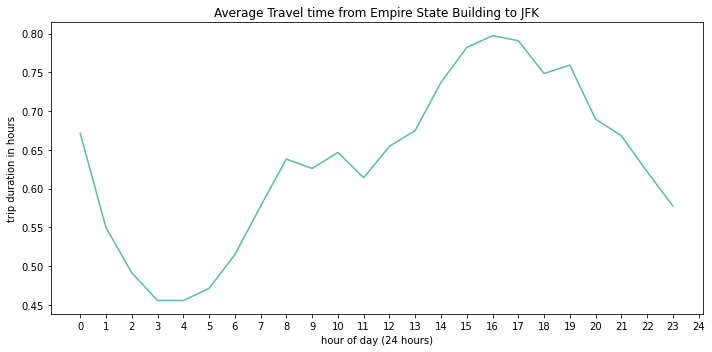

In [232]:
plt.plot(t1.values, color='#53BF9D')
plt.xticks(range(0, 25))
plt.title('Average Travel time from Empire State Building to JFK')
plt.xlabel('hour of day (24 hours)')
plt.ylabel('trip duration in hours')
plt.tight_layout()
plt.rcParams["figure.figsize"] = (10,5)

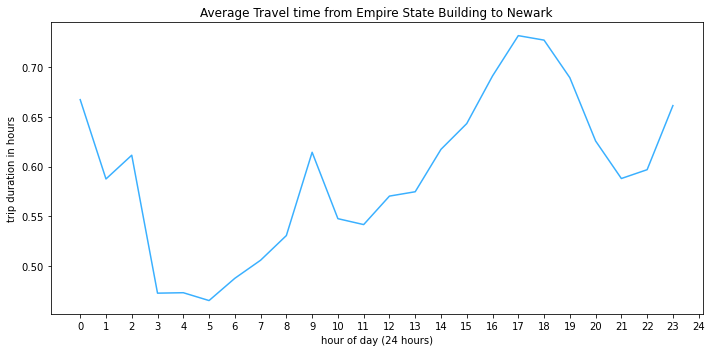

In [233]:
plt.plot(t2.values, color='#3AB0FF')
plt.xticks(range(0, 25))
plt.title('Average Travel time from Empire State Building to Newark')
plt.xlabel('hour of day (24 hours)')
plt.ylabel('trip duration in hours')
plt.tight_layout()
plt.rcParams["figure.figsize"] = (10,5)

### Boroughs

In [173]:
newyork = gpd.read_file('Shape_files/geo_export_2e44e474-04cb-4bdb-98aa-1abd21250fa1.shp')
newyork = newyork.to_crs(4326)

In [189]:
crs = {'init': 'epsg:4326'} 

In [181]:
geo_df = gpd.GeoDataFrame(train_new,crs = crs ,
                          geometry = gpd.points_from_xy(train_new.pickup_longitude,train_new.pickup_latitude))

C:\Users\Rushil\anaconda3\envs\geo_env\lib\site-packages\pyproj\crs\crs.py:130: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


In [184]:
geo_df =geo_df.to_crs(4326)

In [185]:
join = gpd.tools.sjoin(geo_df,newyork,how='left')

In [191]:
geo_df2 = gpd.GeoDataFrame(train_new,crs = crs ,
                          geometry = gpd.points_from_xy(train_new.dropoff_longitude,train_new.dropoff_latitude))

C:\Users\Rushil\anaconda3\envs\geo_env\lib\site-packages\pyproj\crs\crs.py:130: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


In [192]:
geo_df2 =geo_df2.to_crs(4326)

In [193]:
join2 = gpd.tools.sjoin(geo_df2,newyork,how='left')

Text(0.5, 69.0, 'Longitude')

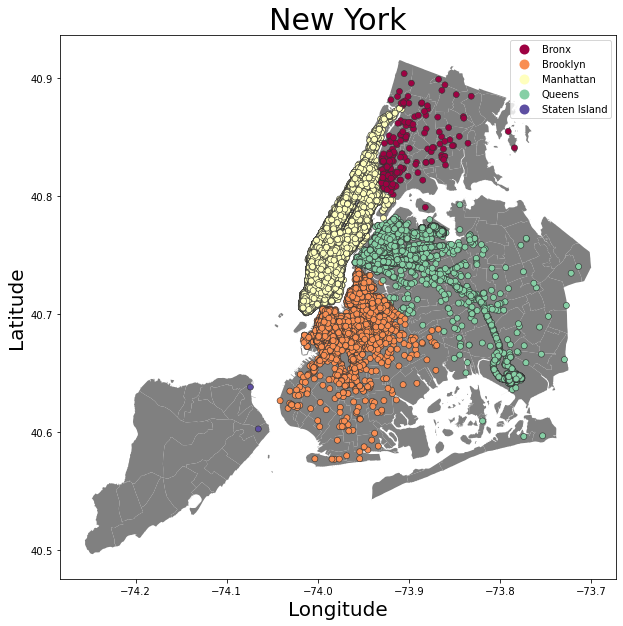

In [196]:
fig, ax = plt.subplots(figsize = (10,10))
newyork.plot(ax=ax, color='grey')
join.plot(column='boro_name',categorical=True, linewidth=.6, edgecolor='0.2',ax=ax, cmap='Spectral', legend=True)

ax.set_title('New York',fontdict = {'fontsize': 20})
ax.set_ylabel('Latitude',fontdict = {'fontsize': 16})
ax.set_xlabel('Longitude',fontdict = {'fontsize': 16})

Text(0.5, 69.0, 'Longitude')

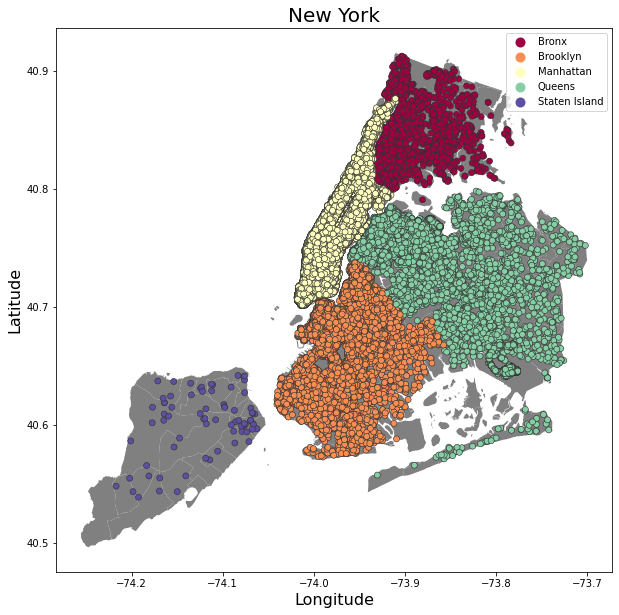

In [197]:
fig, ax = plt.subplots(figsize = (10,10))
newyork.plot(ax=ax, color='grey')
join2.plot(column='boro_name',categorical=True, linewidth=.6, edgecolor='0.2',ax=ax, cmap='Spectral', legend=True)

ax.set_title('New York',fontdict = {'fontsize': 20})
ax.set_ylabel('Latitude',fontdict = {'fontsize': 16})
ax.set_xlabel('Longitude',fontdict = {'fontsize': 16})

In [199]:
join['boro_name'].value_counts()

Manhattan        342328
Queens            20717
Brooklyn           6835
Bronx               259
Staten Island         2
Name: boro_name, dtype: int64

In [200]:
print('Manhattan has the most pickups')

Manhattan has the most pickups


In [201]:
join2['boro_name'].value_counts()

Manhattan        327740
Brooklyn          19912
Queens            18822
Bronx              2376
Staten Island        74
Name: boro_name, dtype: int64

In [202]:
print('Manhattan has the most dropoffs')

Manhattan has the most dropoffs


In [206]:
join['hour_of_day'] = join['dropoff_datetime'].apply(lambda x: x.hour)

In [207]:
join2['hour_of_day'] = join2['dropoff_datetime'].apply(lambda x: x.hour)

In [209]:
pickup_5am = join[(join['hour_of_day']>=0) & (join['hour_of_day']<=5)]

In [211]:
dropff_5am = join2[(join2['hour_of_day']>=0) & (join2['hour_of_day']<=5)]

In [218]:
l = pickup_5am['boro_name'].value_counts()

In [216]:
 k = dropff_5am['boro_name'].value_counts()

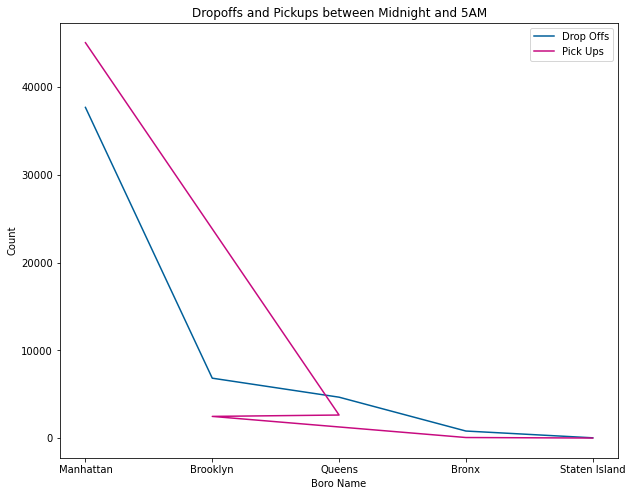

In [224]:
plt.plot(k, label='Drop Offs', color='#005F99')
plt.plot(l, label='Pick Ups',color='#C70A80')

plt.title('Dropoffs and Pickups between Midnight and 5AM')
plt.legend(loc='upper right')
plt.xlabel('Boro Name')
plt.ylabel('Count')

plt.rcParams["figure.figsize"] = (10,8)